<a href="https://colab.research.google.com/github/tikhongc/1/blob/main/Creating_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import library

In [ ]:
import librosa 
import matplotlib.pyplot as plt
import librosa.display
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import numpy
import skimage.io
import os
import shutil
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn
import librosa.display as lplt
import librosa
import librosa.display
import IPython.display as ipd
import IPython
import warnings
warnings.filterwarnings('ignore')
import os

from librosa import feature
import csv
import glob

! pip install pydub
from pydub import AudioSegment

# About Audio

These are the code just for a reference,it contains:

1.   information about song
2.   diiferent audio features extrated from data and plot them



## Audio data

In [ ]:
general_path = '../content/drive/MyDrive/Data'
print(list(os.listdir(f'{general_path}/genres_original/')))

['rock', 'pop', 'disco', 'classical', 'jazz', 'blues', 'metal', 'hiphop', 'reggae', 'country']


In [ ]:
# Importing 1 file
y, sr = librosa.load('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')

print('y:', y, '\n')
print('y shape:', np.shape(y), '\n')
print('Sample Rate (KHz):', sr, '\n')
a=np.shape(y)
arr = np.asarray(a)
print(arr)
# Verify length of the audio
print('Check Len of Audio:', 661794/22050)

y: [-0.03973389 -0.07177734 -0.08184814 ... -0.05267334 -0.07305908
 -0.08856201] 

y shape: (661794,) 

Sample Rate (KHz): 22050 

[661794]
Check Len of Audio: 30.013333333333332


In [ ]:
IPython.display.Audio(y, rate=sr)

In [ ]:
# Trim leading and trailing silence from an audio signal (silence before and after the actual audio)
y, _ = librosa.effects.trim(y)

# the result is an numpy ndarray
print('Audio File:', y, '\n')
print('Audio File shape:', np.shape(y))

Audio File: [-0.12936401 -0.21520996 -0.20806885 ...  0.11901855  0.07955933
  0.04376221] 

Audio File shape: (661794,)


In [ ]:
IPython.display.Audio(audio_file, rate=sr)

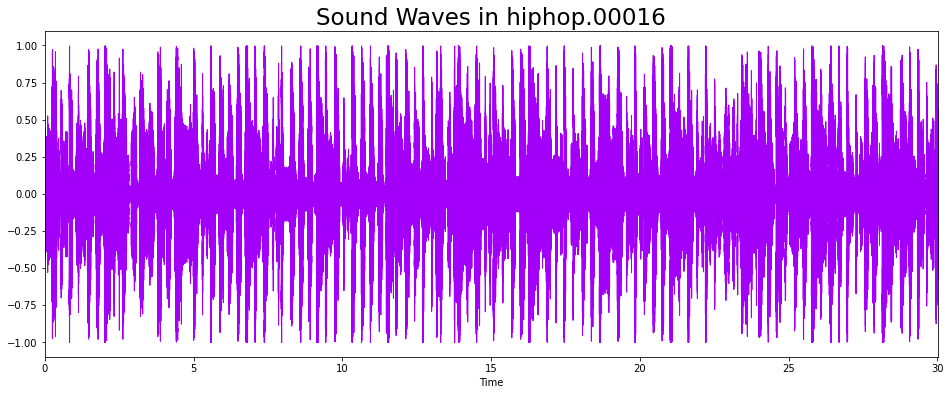

In [ ]:
plt.figure(figsize = (16, 6))
librosa.display.waveplot(y = audio_file, sr = sr, color = "#A300F9");
plt.title("Sound Waves in hiphop.00016", fontsize = 23);

## slice the audio

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')
IPython.display.Audio(y, rate=sr)

In [ ]:
newAudio = AudioSegment.from_wav('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')
ten_seconds = 10 * 1000 
first_10s = newAudio[:ten_seconds] 
mid_10s = newAudio[-20000:-10000]
last_10s = newAudio[-10000:]
first_10s.export('/content/drive/MyDrive/Data/newSong.wav', format="wav") #Exports to a wav file in the current path.
y, sr = librosa.load('/content/drive/MyDrive/Data/newSong.wav')
IPython.display.Audio(y, rate=sr)

## Audio Feature 
About features that get from an audio. Take it as a reference and a tool box.
Not using these code in my project.

reference : https://towardsdatascience.com/extract-features-of-music-75a3f9bc265d

In [ ]:
audio_file, sr = librosa.load('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')

### Zero Crossing Rate
the rate at which the signal changes from positive to negative or back.

In [ ]:
# Total zero_crossings in our 1 song
zero_crossings = librosa.zero_crossings(audio_file, pad=False)
print(sum(zero_crossings))

73126


### Harmonics and Perceptrual
將音頻時間序列分解為諧波和打擊樂成分。


Harmonics are characteristichs that human ears can't distinguish (represents the sound color)

Perceptrual understanding shock wave represents the sound rhythm and emotion

In [ ]:
y_harm, y_perc = librosa.effects.hpss(audio_file)

harm_mean = np.mean(y_harm.T,axis=0)
perc_mean = np.mean(y_perc.T,axis=0)
perc_mean

-0.0004253785

In [ ]:
plt.figure(figsize = (16, 6))
plt.plot(y_harm, color = '#A300F9');
plt.plot(y_perc, color = '#FFB100');



### Tempo BMP (beats per minute)
Dynamic programming beat tracker.

In [ ]:
tempo, _ = librosa.beat.beat_track(y, sr = sr)
tempo

107.666015625

### Spectral Centroid¶

indicates where the ”centre of mass” for a sound is located and is calculated as the weighted mean of the frequencies present in the sound.

In [ ]:
# Calculate the Spectral Centroids
spectral_centroids = librosa.feature.spectral_centroid(audio_file, sr=sr)[0]

# Shape is a vector
print('Centroids:', spectral_centroids, '\n')
print('Shape of Spectral Centroids:', spectral_centroids.shape, '\n')

# Computing the time variable for visualization
frames = range(len(spectral_centroids))

# Converts frame counts to time (seconds)
t = librosa.frames_to_time(frames)

print('frames:', frames, '\n')
print('t:', t)

# Function that normalizes the Sound Data
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

Centroids: [1587.06746224 1785.44845127 2211.20395522 ... 1348.06171208 1141.8282052
  943.66173546] 

Shape of Spectral Centroids: (1293,) 

frames: range(0, 1293) 

t: [0.00000000e+00 2.32199546e-02 4.64399093e-02 ... 2.99537415e+01
 2.99769615e+01 3.00001814e+01]


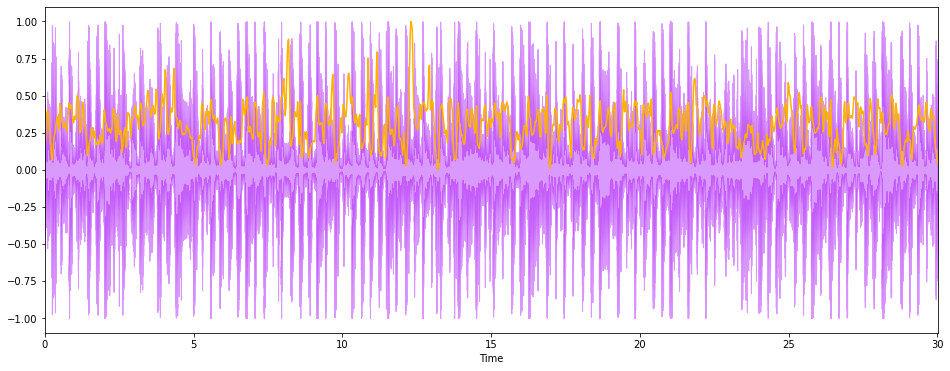

In [ ]:
#Plotting the Spectral Centroid along the waveform
plt.figure(figsize = (16, 6))
librosa.display.waveplot(audio_file, sr=sr, alpha=0.4, color = '#A300F9');
plt.plot(t, normalize(spectral_centroids), color='#FFB100');

### Mel-Frequency Cepstral Coefficients:

The Mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features 
(usually about 10–20) which concisely describe the overall shape of a spectral envelope. It models the characteristics of the human voice.

mfccs shape: (20, 1293)


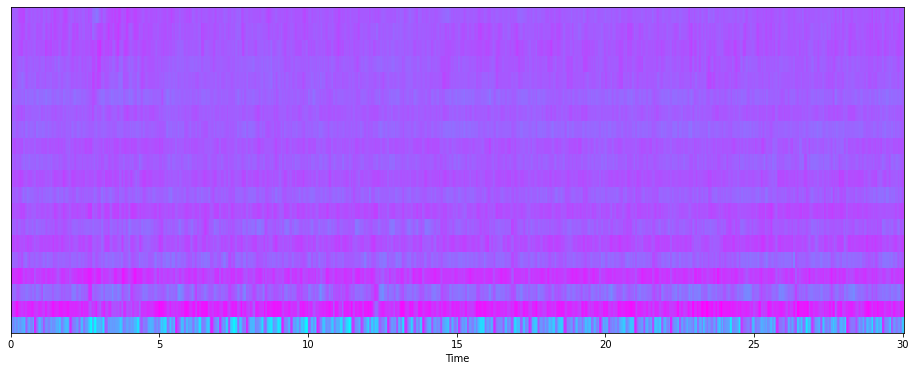

In [ ]:
mfccs = librosa.feature.mfcc(audio_file, sr=sr)
print('mfccs shape:', mfccs.shape)

#Displaying  the MFCCs:
plt.figure(figsize = (16, 6))
librosa.display.specshow(mfccs, sr=sr, x_axis='time', cmap = 'cool');

Mean: 5.9005373e-10 

Var: 1.0000001


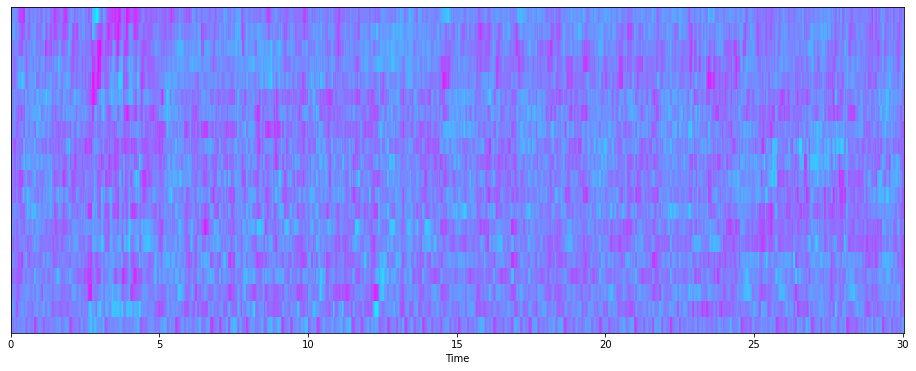

In [ ]:
# Perform Feature Scaling
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print('Mean:', mfccs.mean(), '\n')
print('Var:', mfccs.var())

plt.figure(figsize = (16, 6))
librosa.display.specshow(mfccs, sr=sr, x_axis='time', cmap = 'cool');

### Chroma Frequencies¶

Chroma features are an interesting and powerful representation for music audio in which the entire spectrum is projected onto 12 bins representing the 12 distinct semitones (or chroma) of the musical octave.

Chromogram shape: (12, 133)


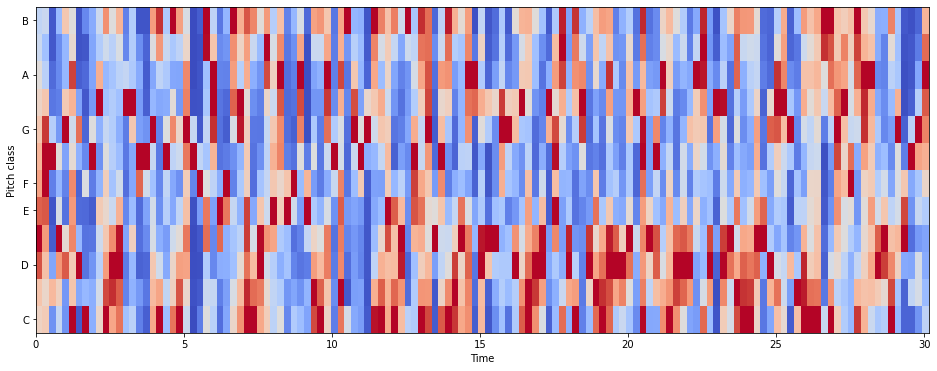

In [ ]:
# Increase or decrease hop_length to change how granular you want your data to be
hop_length = 5000

# Chromogram
chromagram = librosa.feature.chroma_stft(audio_file, sr=sr, hop_length=hop_length)
print('Chromogram shape:', chromagram.shape)

plt.figure(figsize=(16, 6))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm');

In [ ]:
# Default FFT window size
n_fft = 2048 # FFT window size
hop_length = 512 # number audio of frames between STFT columns (looks like a good default)

# Short-time Fourier transform (STFT)
D = np.abs(librosa.stft(audio_file, n_fft = n_fft, hop_length = hop_length))

print('Shape of D object:', np.shape(D))

Shape of D object: (1025, 1293)


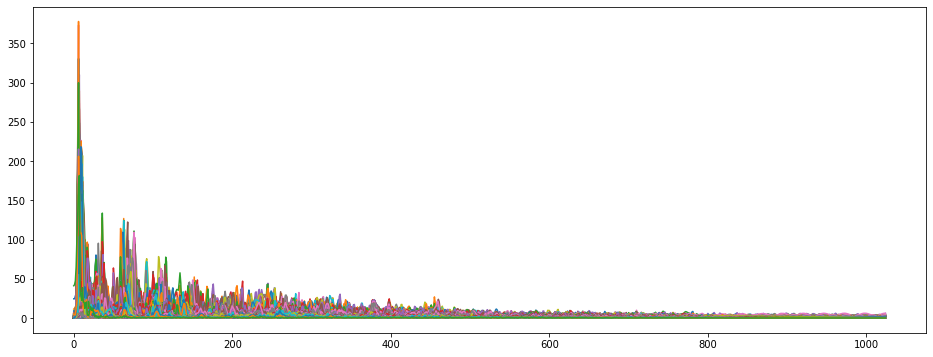

In [ ]:
plt.figure(figsize = (16, 6))
plt.plot(D);

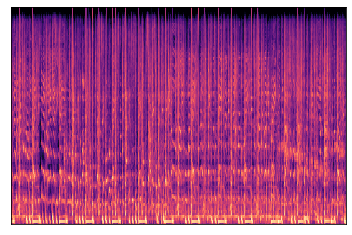

In [ ]:
N_FFT = 2048
N_MELS = 128
HOP_LEN = 512
y, sfr = librosa.load('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')

melSpec = librosa.feature.melspectrogram(y=y, sr=sfr, n_mels=N_MELS,hop_length=HOP_LEN, n_fft=N_FFT)
melSpec_dB = librosa.power_to_db(melSpec, ref=np.max)

librosa.display.specshow(melSpec_dB)

#Creating Dataset

## cut the audio into different length

The dataset contains 30s length for each song.

I would like to cut the aduio into different segment (10s/track) .

And then lable them and save into a new file

In [ ]:
newAudio = AudioSegment.from_wav('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/genres_original/hiphop/hiphop.00016.wav')
ten_seconds = 10 * 1000 
first_10s = newAudio[:ten_seconds] 
mid_10s = newAudio[-20000:-10000]
last_10s = newAudio[-10000:]
mid_10s.export('/content/drive/MyDrive/Data/newSong.wav', format="wav") #Exports to a wav file in the current path.
y, sr = librosa.load('/content/drive/MyDrive/Data/newSong.wav')
IPython.display.Audio(y, rate=sr)

In [ ]:
  A=[]
  filePath = '/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/genres_original/'
  length_x = ['first_10s','mid_10s','last_10s']
  ten_seconds = 10 * 1000 
  A=os.listdir(filePath)
  m=0
  for k in length_x:
    path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/'+k+'/'
    print(path_saved)
    for i in A:
      source_path = os.path.abspath(filePath+i)
      target_path = os.path.abspath(path_saved+i) 
      if not os.path.exists(target_path):
        os.makedirs(target_path)
      if os.path.exists(source_path):
        B=[]
        B=os.listdir(source_path) 
        B.sort() #sort the loaded file
        folder=i+'/'
        pathAudio=filePath+folder
        files = librosa.util.find_files(pathAudio, ext=['wav']) 
        files = np.asarray(files)
        code = 0;
        for x in files:
          newAudio = AudioSegment.from_wav(x)
          if m==0 :
            # first_10s
            segment = newAudio[:ten_seconds] 
          if m==1 :
            # mid_10s
            segment = newAudio[-20000:-10000]
          if m==2 :
            # last_10s
            segment = newAudio[-10000:]

          audio_name = B[code]
          genre = audio_name.split(".")[0]
          audio = audio_name.split(".")[0]+'.'+audio_name.split(".")[1]
          segment.export(path_saved+genre+'/'+audio+'_'+k+'.wav', format="wav") #Exports to a wav file in the current path.
          code=code+1
    m=m+1
    print(" Export "+k+" audio file finished !")

/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/first_10s/
 Export first_10s audio file finished !
/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/mid_10s/
 Export mid_10s audio file finished !
/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/last_10s/
 Export last_10s audio file finished !


### Test the splitted aduio

successful for splitting the audio !

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Data/genres_original/hiphop/hiphop.00016.wav')
IPython.display.Audio(y, rate=sr)

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/first_10s/hiphop/hiphop.00016_first_10s.wav')
IPython.display.Audio(y, rate=sr)

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/mid_10s/hiphop/hiphop.00016_mid_10s.wav')
IPython.display.Audio(y, rate=sr)

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/last_10s/hiphop/hiphop.00016_last_10s.wav')
IPython.display.Audio(y, rate=sr)

## mel-png-file

1.   use log-melspectrogram
2.   min-max scale to fit inside 8-bit range
3.   save as png file
4.   creating new folders and save them into different genre folders with gnere lable 



In [ ]:
def scale_minmax(X, min=0.0, max=1.0):
    X_std = (X - X.min()) / (X.max() - X.min())
    X_scaled = X_std * (max - min) + min
    return X_scaled

def spectrogram_image(y, sr, out, hop_length, n_mels):
    # use log-melspectrogram
    mels = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=n_mels,n_fft=hop_length*2, hop_length=hop_length)
    mels = numpy.log(mels + 1e-9) # add small number to avoid log(0)
    # min-max scale to fit inside 8-bit range
    img = scale_minmax(mels, 0, 255).astype(numpy.uint8)
    img = numpy.flip(img, axis=0) # put low frequencies at the bottom in image
    img = 255-img # invert. make black==more energy
    # save as PNG
    skimage.io.imsave(out, img)

if __name__ == '__main__':
    # settings
    hop_length = 512 # number of samples per time-step in spectrogram
    n_mels = 128 # number of bins in spectrogram. Height of image
    time_steps = 384 # number of time-steps. Width of image
   
    A=[]
    #filePath = '/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/genres_original/'
    #path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/All_30s/'
    #create png file for splitted audio
    filePath='/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/first_10s/'
    path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/'
    
    length_aduio_csv='_10s'
    A=os.listdir(filePath)
    for i in A:
      source_path = os.path.abspath(filePath+i)
      target_path = os.path.abspath(path_saved+i) 
      if not os.path.exists(target_path):
        os.makedirs(target_path)
      if os.path.exists(source_path):
        B=[]
        B=os.listdir(source_path) 
        B.sort() #sort the loaded file
        folder=i+'/'
        pathAudio=filePath+folder
        files = librosa.util.find_files(pathAudio, ext=['wav']) 
        files = np.asarray(files)
        code = 0;
        for x in files: 
          y, sr = librosa.load(x)
          # Trim leading and trailing silence from an audio signal (silence before and after the actual audio)
          y, _ = librosa.effects.trim(y)
          audio_name = B[code]
          genre = audio_name.split(".")[0]
          audio = audio_name.split(".")[0] + '.' + audio_name.split(".")[1]
          out = path_saved+folder+audio+'.png'
          code = code+1;
          # extract a fixed length window
          start_sample = 0 # starting at beginning
          length_samples = time_steps*hop_length
          window = y[start_sample:start_sample+length_samples]
          #convert to PNG
          spectrogram_image(window, sr=sr, out=out, hop_length=hop_length, n_mels=n_mels)
          print('wrote file', out)

    print('CREATEING DATASET FINISHED!')



wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00000_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00001_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00002_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00003_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00004_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00005_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00006_first_10s.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/first_10s/rock/rock.00007_first_10s.png
wrote file /content/driv

##csv audio feature file
These files contains the mean and variance for each audio file fo the features analysed above.I take the value of these features and save them into csv file song by song:


---



*   audio name
*   genre
*   length
*   tempo
*   chroma_stft_mean
*   spectral_centroid_mean
*   spectral_bandwidth_mean
*   spectral_rolloff_mean
*   RMS_mean(Root-Mean-Square Error)（它是『預測值』與『實際值』之差的平方和，愈小表示模型愈準確。）
*   zero_crossing_rate_mean
*   13 features of MFCC
*   I also want to take the harm_mean and perc_mean of audio, but it's too slow to run it on this platform


Extract features function

reference:
https://medium.com/@alexandro.ramr777/audio-files-to-dataset-by-feature-extraction-with-librosa-d87adafe5b64

In [ ]:
fn_list_i = [
 feature.chroma_stft,
 feature.spectral_centroid,
 feature.spectral_bandwidth,
 feature.spectral_rolloff
]
 
fn_list_ii = [
 feature.rms,
 feature.zero_crossing_rate
]

 #'harm_mean',
 #'perc_mean',
 
header =[
 'audio_name',
 'genre',
 'length',
 'tempo',
 'chroma_stft_mean',
 'spectral_centroid_mean',
 'spectral_bandwidth_mean',
 'spectral_rolloff_mean',
 'rms_mean',
 'zero_crossing_rate_mean',
 'mfcc1_mean',
 'mfcc2_mean',
 'mfcc3_mean',
 'mfcc4_mean',
 'mfcc5_mean',
 'mfcc6_mean',
 'mfcc7_mean',
 'mfcc8_mean',
 'mfcc9_mean',
 'mfcc10_mean',
 'mfcc11_mean',
 'mfcc12_mean',
 'mfcc13_mean'
]

### method 1
make csv file one by one

In [ ]:
source_path = filePath = '/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/genres_original/blues'
norm_audio_files = glob(source_path + '*.wav')
norm_audios_feat = []
B=[]
B=os.listdir(source_path) 
B.sort() #sort the loaded file
code=0

def get_feature_vector(y,sr): 
   audio_name = B[code]
   genre = audio_name.split(".")[0]
   audio = audio_name.split(".")[0]+audio_name.split(".")[1]
   #calculate the length = shape / sampleling rate
   a=np.shape(y)
   arr = np.asarray(a)
   length = arr[0]/sr #

   feat_vect_i = [np.mean(funct(y,sr)) for funct in fn_list_i]
   feat_vect_ii = [np.mean(funct(y)) for funct in fn_list_ii] 
   feature_vector = [audio] + [genre]+ [length] + feat_vect_i + feat_vect_ii 
   return feature_vector

for file in norm_audio_files:
   y , sr = librosa.load(file,sr=None)
   feature_vector = get_feature_vector(y, sr)
   norm_audios_feat.append(feature_vector) 
   code=code+1;
   print(norm_audios_feat)

[['blues00000', 'blues', 30.013333333333332, 0.3024563, 1831.993939606849, 1729.6532869429993, 3481.5175917198376, 0.10349364, 0.09404153373936582]]
[['blues00000', 'blues', 30.013333333333332, 0.3024563, 1831.993939606849, 1729.6532869429993, 3481.5175917198376, 0.10349364, 0.09404153373936582], ['blues00001', 'blues', 30.013333333333332, 0.35008812, 1784.1658495387549, 2002.4490601176958, 3805.8396058403423, 0.13022792, 0.08304482066898686]]
[['blues00000', 'blues', 30.013333333333332, 0.3024563, 1831.993939606849, 1729.6532869429993, 3481.5175917198376, 0.10349364, 0.09404153373936582], ['blues00001', 'blues', 30.013333333333332, 0.35008812, 1784.1658495387549, 2002.4490601176958, 3805.8396058403423, 0.13022792, 0.08304482066898686], ['blues00002', 'blues', 30.013333333333332, 0.3079548, 1451.6670658428156, 1577.2709414206088, 2954.836759987674, 0.13182218, 0.061442246108855375]]
[['blues00000', 'blues', 30.013333333333332, 0.3024563, 1831.993939606849, 1729.6532869429993, 3481.5175

In [ ]:
norm_output = '/content/drive/MyDrive/Dataset/Music-genre-classification/csv_files/30_secd.csv'

with open(norm_output,'+w') as f:
 csv_writer = csv.writer(f, delimiter = ',')
 csv_writer.writerow(header)
 csv_writer.writerows(norm_audios_feat)


In [ ]:
csv_file= pd.read_csv('/content/drive/MyDrive/Data/normals_00.csv')
csv_file

,audio_name,genre,length,chroma_stft_mean,spectral_centroid_mean,spectral_bandwidth_mean,spectral_rolloff_mean,rms_mean,zero_crossing_rate_mean
0,rock00000,rock,30.013333,0.387577,1996.327664,2097.080528,4227.935352,0.129127,0.090220
1,rock00001,rock,30.013333,0.365396,1529.474961,1845.614892,3271.922752,0.180470,0.054960
2,rock00002,rock,30.013333,0.436806,1875.315631,1983.973789,3929.526458,0.148662,0.076804
3,rock00003,rock,30.013333,0.379949,1421.445980,1902.678467,3042.493384,0.151299,0.043099
4,rock00004,rock,30.013333,0.372798,1345.693061,1841.674809,2938.990787,0.208739,0.041079
...,...,...,...,...,...,...,...,...,...
300,classical00000,classical,30.013333,0.252392,1505.166424,1559.005740,2716.306158,0.036245,0.098223
301,classical00001,classical,30.013333,0.214995,1360.643672,1441.243134,2387.729130,0.030625,0.087766
302,classical00002,classical,30.013333,0.277958,1490.275364,1600.115744,2785.294011,0.043860,0.090046
303,classical00003,classical,30.013333,0.234229,1526.629882,1499.439342,2916.000387,0.029442,0.108946


### method 2:
make list at once, but too slow on platform

In [ ]:
    #directories of normal audios

    #30 sec audio file
    #filePath = '/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/genres_original/'
    #path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/csv_files/30_secd_audio/'
    norm_audios_feat = []
    A=[]
    A=os.listdir(filePath)
    B=[]
    code = 0
    #create csv file for splitted audio
    #filePath='/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/first_10s/'
    #path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/csv_files/first_10s/'
    
    length_aduio_csv='_30s'

    def extract_mfcc_features(y,sr):
      mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
      mfccs_processed = np.mean(mfccs.T,axis=0)
      return mfccs_processed

    def get_tempo(y,sr):
      onset_env = librosa.onset.onset_strength(y, sr=sr)
      tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)
      tempo = np.array(tempo)
      return tempo

    def get_harm_mean(y,sr):
      y_harm, y_perc = librosa.effects.hpss(audio_file)
      harm_mean = np.mean(y_harm.T,axis=0)
      return harm_mean

    def get_perc_mean(y,sr):
      y_harm, y_perc = librosa.effects.hpss(audio_file)
      perc_mean = np.mean(y_perc.T,axis=0)
      return perc_mean

    def get_feature_vector(y,sr): 
       audio_name = B[code]
       genre = audio_name.split(".")[0]
       audio = audio_name.split(".")[0]+audio_name.split(".")[1]
       #calculate the length = shape / sampleling rate
       a=np.shape(y)
       arr = np.asarray(a)
       length = arr[0]/sr #
       #harm_mean = [get_harm_mean(y,sr)]
       #perc_mean = [get_perc_mean(y,sr)]
       feat_vect_i = [np.mean(funct(y,sr)) for funct in fn_list_i]
       feat_vect_ii = [np.mean(funct(y)) for funct in fn_list_ii]
       tempo = get_tempo(y,sr)
       feat_tempo=[]
       for k in tempo :
         feat_tempo.append(k)
       feat_mfcc = extract_mfcc_features(y,sr)
       features_mfcc=[]
       for i in feat_mfcc :
         features_mfcc.append(i)  
       feature_vector = [audio] + [genre]+ [length] + feat_tempo +  feat_vect_i + feat_vect_ii + features_mfcc
       return feature_vector            
       
    for i in A:
      norm_audios_feat = []
      source_path = os.path.abspath(filePath+i)
      target_path = os.path.abspath(path_saved) 
      if not os.path.exists(target_path):
        os.makedirs(target_path)
      if os.path.exists(source_path):
        B=[]
        B=os.listdir(source_path) 
        B.sort() #sort the loaded file
        folder=i+'/'
        pathAudio=filePath+folder
        files = librosa.util.find_files(pathAudio, ext=['wav']) 
        files = np.asarray(files)
        code = 0
        for x in files: 
          y, sr = librosa.load(x)
          feature_vector = get_feature_vector(y, sr)
          norm_audios_feat.append(feature_vector) 
          code=code+1
          print(norm_audios_feat)
        norm_output=path_saved+i+length_aduio_csv+'.csv'
        with open(norm_output,'+w') as f:
          csv_writer = csv.writer(f, delimiter = ',')
          csv_writer.writerow(header)
          csv_writer.writerows(norm_audios_feat)
          


[['rock00000', 'rock', 30.013333333333332, 123.046875, 0.38757712, 1996.327664393569, 2097.080527547891, 4227.935352015661, 0.12912735, 0.09022025147428461, -116.60436, 109.2507, -23.165134, 40.68874, -11.888447, 23.15809, -15.411178, 15.128495, -13.53074, 12.694694, -10.87374, 8.501457, -11.581522]]
[['rock00000', 'rock', 30.013333333333332, 123.046875, 0.38757712, 1996.327664393569, 2097.080527547891, 4227.935352015661, 0.12912735, 0.09022025147428461, -116.60436, 109.2507, -23.165134, 40.68874, -11.888447, 23.15809, -15.411178, 15.128495, -13.53074, 12.694694, -10.87374, 8.501457, -11.581522], ['rock00001', 'rock', 30.013333333333332, 151.99908088235293, 0.36539575, 1529.474960625274, 1845.6148917301423, 3271.9227518670245, 0.18046966, 0.05495977438611756, -111.22388, 134.12848, -24.652063, 41.524403, -3.0621228, 28.465319, -10.584466, 14.914135, -14.391981, 8.840387, -4.534185, 9.934852, -4.6733027]]
[['rock00000', 'rock', 30.013333333333332, 123.046875, 0.38757712, 1996.3276643935

In [ ]:
csv_file= pd.read_csv(path_saved+'hiphop_10s.csv')
csv_file

combine csv file of different gernes into one csv file

reference: https://www.freecodecamp.org/news/how-to-combine-multiple-csv-files-with-8-lines-of-code-265183e0854/

In [30]:
    os.chdir(path_saved)
    extension = 'csv'
    all_filenames = [i for i in glob.glob('*.{}'.format(extension))]
    #combine all files in the list
    combined_csv = pd.concat([pd.read_csv(f) for f in all_filenames ])
    #export to csv
    combined_csv.to_csv(path_saved+'audio_features'+length_aduio_csv+'.csv', index=False, encoding='utf-8-sig')
    B=os.listdir(path_saved)
    for i in B :
       print (i)

rock_30s.csv
pop_30s.csv
disco_30s.csv
classical_30s.csv
jazz_30s.csv
blues_30s.csv
metal_30s.csv
hiphop_30s.csv
reggae_30s.csv
country_30s.csv
audio_features_30s.csv


In [32]:
csv_file= pd.read_csv('/content/drive/MyDrive/Dataset/Music-genre-classification//csv_files/30_secd_audio/audio_features'+length_aduio_csv+'.csv')
csv_file

,audio_name,genre,length,tempo,chroma_stft_mean,spectral_centroid_mean,spectral_bandwidth_mean,spectral_rolloff_mean,rms_mean,zero_crossing_rate_mean,mfcc1_mean,mfcc2_mean,mfcc3_mean,mfcc4_mean,mfcc5_mean,mfcc6_mean,mfcc7_mean,mfcc8_mean,mfcc9_mean,mfcc10_mean,mfcc11_mean,mfcc12_mean,mfcc13_mean
0,rock00000,rock,30.013333,123.046875,0.387577,1996.327664,2097.080528,4227.935352,0.129127,0.090220,-116.604360,109.250700,-23.165134,40.688740,-11.888447,23.158090,-15.411178,15.128495,-13.530740,12.694694,-10.873740,8.501457,-11.581522
1,rock00001,rock,30.013333,151.999081,0.365396,1529.474961,1845.614892,3271.922752,0.180470,0.054960,-111.223880,134.128480,-24.652063,41.524403,-3.062123,28.465319,-10.584466,14.914135,-14.391981,8.840387,-4.534185,9.934852,-4.673303
2,rock00002,rock,30.013333,107.666016,0.436806,1875.315631,1983.973789,3929.526458,0.148662,0.076804,-120.403230,117.563330,-27.613575,42.830257,-6.729611,21.624240,-12.094098,17.932444,-10.451455,12.271442,-6.544395,13.512891,-2.409186
3,rock00003,rock,30.013333,95.703125,0.379949,1421.445980,1902.678467,3042.493384,0.151299,0.043099,-156.540120,130.713610,-1.466156,36.217285,0.367364,31.955133,-0.615616,20.145870,-11.344087,13.852134,-3.781855,11.536494,-3.209727
4,rock00004,rock,30.013333,103.359375,0.372798,1345.693061,1841.674809,2938.990787,0.208739,0.041079,-127.948870,134.445080,1.018328,54.449253,-0.454011,35.819710,-10.859722,16.391262,-10.032810,6.590871,-6.695050,11.037278,-8.381531
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,country00095,country,30.013333,89.102909,0.328869,1557.683895,1762.184371,3220.920869,0.175337,0.067367,-124.767450,127.314720,-23.385271,47.384247,0.572850,16.016810,-9.985472,16.203802,-16.741410,6.792562,-8.200077,3.205722,-1.603722
995,country00096,country,30.013333,117.453835,0.325745,1754.279131,1861.891710,3505.040909,0.218129,0.097413,-69.813240,124.211160,-32.481983,47.689655,1.402723,22.611412,-8.744138,21.426990,-15.670838,15.738124,-12.439984,9.570571,-9.043077
996,country00097,country,30.013333,112.347147,0.348078,1560.970440,1782.663018,3175.106606,0.153142,0.067199,-148.325940,126.863160,-19.567993,52.851450,8.588254,17.879751,-8.078774,17.778482,-15.498923,13.507554,-10.954303,9.461726,-1.917736
997,country00098,country,30.013333,117.453835,0.270818,1425.010296,1690.948858,2980.125367,0.176322,0.061722,-139.558940,128.807740,-20.222406,49.419296,-2.161149,16.970991,-8.320387,9.811275,-20.126810,2.491771,-11.236035,3.769312,-6.397823


In [ ]:
    A=[]
    filePath = '/content/drive/MyDrive/Data/genres_original/'
    path_saved='/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/'
    A=os.listdir(filePath)
    for i in A:
      source_path = os.path.abspath(filePath+i)
      target_path = os.path.abspath(path_saved+i)
      B=[]
      listdir = lambda f: sorted(os.listdir(f))
      B=os.listdir(source_path) 
      print(B) 
      

['rock.00003.wav', 'rock.00008.wav', 'rock.00004.wav', 'rock.00002.wav', 'rock.00005.wav', 'rock.00006.wav', 'rock.00000.wav', 'rock.00001.wav', 'rock.00007.wav', 'rock.00019.wav', 'rock.00014.wav', 'rock.00015.wav', 'rock.00017.wav', 'rock.00020.wav', 'rock.00013.wav', 'rock.00011.wav', 'rock.00016.wav', 'rock.00018.wav', 'rock.00010.wav', 'rock.00012.wav', 'rock.00009.wav', 'rock.00031.wav', 'rock.00022.wav', 'rock.00030.wav', 'rock.00027.wav', 'rock.00021.wav', 'rock.00028.wav', 'rock.00032.wav', 'rock.00024.wav', 'rock.00033.wav', 'rock.00026.wav', 'rock.00029.wav', 'rock.00025.wav', 'rock.00023.wav', 'rock.00039.wav', 'rock.00035.wav', 'rock.00042.wav', 'rock.00041.wav', 'rock.00046.wav', 'rock.00037.wav', 'rock.00034.wav', 'rock.00044.wav', 'rock.00047.wav', 'rock.00043.wav', 'rock.00038.wav', 'rock.00040.wav', 'rock.00036.wav', 'rock.00045.wav', 'rock.00057.wav', 'rock.00058.wav', 'rock.00049.wav', 'rock.00059.wav', 'rock.00054.wav', 'rock.00055.wav', 'rock.00052.wav', 'rock.000

In [ ]:
filePath = '/content/drive/MyDrive/Data/genres_original/blues/'
files = librosa.util.find_files(pathAudio, ext=['wav']) 
import numpy as np


import os
path_list=os.listdir(filePath)
path_list.sort() #对读取的路径进行排序
for filename in path_list:
	print(os.path.join(path,filename))


/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00000.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00001.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00002.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00003.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00004.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00005.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00006.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00007.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00008.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues.00009.wav
/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img

In [ ]:
def scale_minmax(X, min=0.0, max=1.0):
    X_std = (X - X.min()) / (X.max() - X.min())
    X_scaled = X_std * (max - min) + min
    return X_scaled

def spectrogram_image(y, sr, out, hop_length, n_mels):
    # use log-melspectrogram
    mels = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=n_mels,n_fft=hop_length*2, hop_length=hop_length)
    mels = numpy.log(mels + 1e-9) # add small number to avoid log(0)
    # min-max scale to fit inside 8-bit range
    img = scale_minmax(mels, 0, 255).astype(numpy.uint8)
    img = numpy.flip(img, axis=0) # put low frequencies at the bottom in image
    img = 255-img # invert. make black==more energy

    # save as PNG
    skimage.io.imsave(out, img)

if __name__ == '__main__':
    # settings
    hop_length = 512 # number of samples per time-step in spectrogram
    n_mels = 128 # number of bins in spectrogram. Height of image
    time_steps = 384 # number of time-steps. Width of image

    A=[]
    filePath = '/content/drive/MyDrive/Data/genres_original/'
    A=os.listdir(filePath)
    for i in A:
      source_path = os.path.abspath(filePath+i)
      target_path = os.path.abspath('/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/'+i)  
      if not os.path.exists(target_path):
        os.makedirs(target_path)
      if os.path.exists(source_path):
        

    print('copy files finished!')

    # load more files with librosa
    pathAudio = "/content/drive/MyDrive/Data/genres_original/blues/"
    folder_name='blues/'
    file_name='blues'
    path='/content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/'+folder_name;
    files = librosa.util.find_files(pathAudio, ext=['wav']) 
    files = np.asarray(files)
    code = 0;
    os.makedirs(path)
    for x in files: 
      y, sr = librosa.load(x)
      out = path+file_name+str(code)+'.png'
      code = code +1;
      # extract a fixed length window
      start_sample = 0 # starting at beginning
      length_samples = time_steps*hop_length
      window = y[start_sample:start_sample+length_samples]
      #convert to PNG
      spectrogram_image(window, sr=sr, out=out, hop_length=hop_length, n_mels=n_mels)
      print('wrote file', out)



wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues0.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues1.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues2.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues3.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues4.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues5.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues6.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues7.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues8.png
wrote file /content/drive/MyDrive/Dataset/Music-genre-classification/mel-spec-img/blues/blues9.png
wrote file

In [ ]:

path = "test_user_info.py"
suffix = path.split(".")[0]
print("filename: {}".format(suffix))

filename: test_user_info


### MFCC-PNG

In [ ]:
mfccs = librosa.feature.mfcc(y=librosa_audio, sr=librosa_sample_rate, n_mfcc = 40)
print (mfccs.shape)
plt.figure(figsize=(8,8))
librosa.display.specshow(mfccs, sr=librosa_sample_rate, x_axis='time')
plt.savefig('MFCCs.png')
experiment.log_image('MFCCs.png')

In [ ]:
def extract_features(file_name):
    audio, sample_rate = librosa.load(file_name, res_type='kaiser_fast') 
    mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=13)
    mfccs_processed = np.mean(mfccs.T,axis=0)
    return mfccs_processed
features = []
 
#file_name = os.path.join(os.path.abspath(fulldatasetpath),'fold'+str(row["fold"])+'/',str(row["slice_file_name"]))
y, sr = librosa.load('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/mid_10s/hiphop/hiphop.00016_mid_10s.wav')

data = extract_features(file_name)
for i in data :
  print(i)
  features.append(i)
print(features)
# Convert into a Panda dataframe 
#featuresdf = pd.DataFrame(features, columns=['feature','class_label'])

-88.116165
77.38243
-19.074242
51.60706
-11.755339
22.242895
-4.7267847
20.127941
-8.322616
14.621041
-3.8004224
8.593772
-11.461993
[-88.116165, 77.38243, -19.074242, 51.60706, -11.755339, 22.242895, -4.7267847, 20.127941, -8.322616, 14.621041, -3.8004224, 8.593772, -11.461993]


In [ ]:
featuresdf.iloc[0]['feature']

array([-88.116165 ,  77.38243  , -19.074242 ,  51.60706  , -11.755339 ,
        22.242895 ,  -4.7267847,  20.127941 ,  -8.322616 ,  14.621041 ,
        -3.8004224,   8.593772 , -11.461993 ], dtype=float32)

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/Dataset/Music-genre-classification/audio_files/mid_10s/hiphop/hiphop.00016_mid_10s.wav')
onset_env = librosa.onset.onset_strength(y, sr=sr)
tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)

tempo = np.array(tempo)

for i in tempo :
  print(tempo)

[99.38401442]
